# HW2: Dynamics and Model Discovery
---
From a limited dataset of 20th century esoteric Canadian wildlife populations, several models are derived. Using Dy- namic Mode Decomposition, time-embedding, Lotka-Voltera fitting, and SINDy models are compared using information metrics. The report ends with a brief furore into a beautiful chemical reaction - an amazing case study of DMD utility.

## Ugly initialisations and library stuff

In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import scipy.interpolate
import pydmd # oopsie
from sklearn import linear_model
from sklearn import model_selection
from matplotlib import animation
import h5py
import imageio
import glob
from IPython import display

In [2]:
# My Colour scheme
#  every self-respecting/loathing millenial has their own, right?
orange = '#FFA500'
millenialPink = '#FFAADD'
mediumAquamarine = '#66CDAA'

## Data setup
The data seems to be given just in the brief PDF, I transcribed to the accompanying CSV. In this section we load into an array.

In [3]:
# Find and load CSV with original data
filePath = './lynxSnowshoePop.csv'
data = np.genfromtxt(filePath,delimiter=',',dtype=int)[1:] # 1: to remove the header
print('Initial data shape:')
print(data.shape)

Initial data shape:
(30, 3)


In [4]:
# Useful cosntants
N = 1024
YEARS = 60 # or 58?
YEAR1 = 1845
YEARend = 1903

In [5]:
# Create interpolated dataset
xNew = np.linspace(1845,1903,N)
x1 = scipy.interpolate.interp1d(data[:,0],data[:,1],kind=3)
x2 = scipy.interpolate.interp1d(data[:,0],data[:,2],kind=3)
data = np.array([xNew,x1(xNew),x2(xNew)]).T
print('Interpolated data shape:')
print(data.shape)

Interpolated data shape:
(1024, 3)


## Question 1: Develop a DMD model to forecast the future population states

In [6]:
# Create X and X'
#  Xp is time progressed X, as per DMD algorithm
X = np.expand_dims(data[:-1,1],axis=1)
Xp = np.expand_dims(data[1:,1],axis=1)
X = data[:-1,1:].T
Xp = data[1:,1:].T
X = np.array(X)
Xp = np.array(Xp)
print([X.shape,Xp.shape])

[(2, 1023), (2, 1023)]


In [7]:
def DMD(X,Xp,r):
    # Step 1: Compute SVD of X
    U,S,Vh = np.linalg.svd(X,full_matrices=0)
    #  substep: reduce rank
    Ut = U[:,:r]
    St = np.diag(S[:r])
    Vht = Vh[:r,:]
    # Step 2: Compute A
    #  At = UHtX'VtSt^-1'
    # => AtSt = UtX'Vt
    # => St^TAt^T = (UtX'Vt)^T
    #At = np.linalg.solve(St.T,(Ut.T @ Xp @ Vt).T).T
    At = np.linalg.solve(St.T,(Ut.T@Xp@Vht.T).T).T
    # Step 3: Compute eigenvalues of A
    L,W = np.linalg.eig(At)
    L = np.diag(L)
    # Step 4: Compute modes
    P = Xp @ Vht.T @ np.linalg.inv(St) @ W # DMD modes
    x1t = (St@Vht[:,0])
    b = np.linalg.solve(W@L,x1t)
    return [P,L,b]

In [8]:
U,Sigma,VT = np.linalg.svd(X)

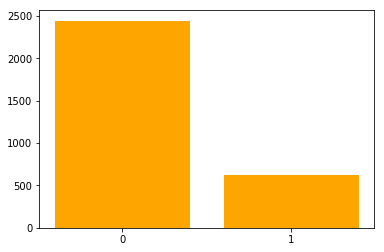

In [9]:
# And hence we shall learn that a truncation of 2 is suitable
[start,end] = [0,10]
plt.bar(range(len(Sigma[start:end])),Sigma[start:end],color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.savefig('./Images/firstDMDSigma.png')

In [10]:
# WeHay, here we go
[P,L,b] = DMD(X,Xp,2)

In [11]:
print([P.shape,L.shape,b.shape])
print(L)

[(2, 2), (2, 2), (2,)]
[[0.9994418+0.00759153j 0.       +0.j        ]
 [0.       +0.j         0.9994418-0.00759153j]]


In [12]:
#O = np.log(L)/2
#print(O)
dmdX = np.zeros(X.shape,dtype=complex)
dt = 1
for i in range(X.shape[1]):
    for j in range(X.shape[0]):
        w = np.log(L[j,j])/dt
        dmdX[:,i] += P[:,j] * np.exp(i*w) * b[j]

In [13]:
def PredictDMD(P,L,b,T,dt=1,t0=0):
    results = np.zeros([T,P.shape[0]],dtype=complex)
    for i in range(T):
        for j in range(b.shape[0]):
            w = np.log(L[j,j])/dt
            results[i] += P[:,j] * np.exp(i*w) * b[j]
    return results 

In [14]:
dmdXt = PredictDMD(P,L,b,N)
print(dmdXt.shape)
print(dmdXt[:,0].shape[0])

(1024, 2)
1024


In [15]:
# Used to get x linspace that works for the Years of dataset
#  Probably a better way to use though - e.g. only change axis labels
def CreateXYear(n,x0=YEAR1,dt=YEARS/N):
    end = x0 + n*dt
    return np.linspace(x0,end,n)

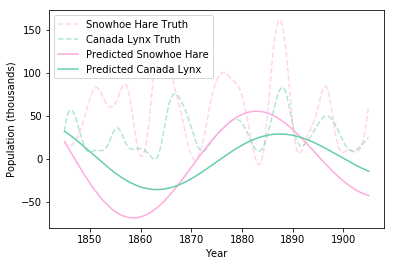

In [16]:
# Plot truth and prediction from ^
fig, ax = plt.subplots()

ax.plot(CreateXYear(X[0].shape[0]),X[0].T,c=millenialPink,alpha=0.5,linestyle='--',label='Snowhoe Hare Truth')
ax.plot(CreateXYear(X[1].shape[0]),X[1].T,c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Truth')
ax.plot(CreateXYear(dmdXt[:,0].shape[0]),np.real(dmdXt[:,0]),c=millenialPink,label='Predicted Snowhoe Hare')
ax.plot(CreateXYear(dmdXt[:,1].shape[0]),np.real(dmdXt[:,1]),c=mediumAquamarine,label='Predicted Canada Lynx')

ax.set_xlabel('Year')
ax.set_ylabel('Population (thousands)')

ax.legend()
plt.savefig('./Images/initalDMD.png')
plt.show()

# Ain't that pretty though - BEAUTIFUL colour scheme

## Question 2: Do a time-delay DMD model to produce a forecast and compare with regular DMD. Determine if it is likely that there are latent variables.


In [17]:
# Hankel Pankel
#  Construct Hankel delay embedding matrix (though possibly not a true [square] Hankel matrix)
#  n #time embeddings
#  m size block of each time embedding
# EWWW, this looks horrible - It's tacky and I hate it
def Hankel(X,n,m):
    H = np.zeros([X.shape[0]*n,m]) # Create empty np array
    for j in range(n):
        for v in range(X.shape[0]):
            H[2*j+v] = X[v,j:j+m]
        #H = H.append(X[j:j+m,1])
    return H

In [18]:
print(X.shape)
m = 150
n = X.shape[1] - m
H = Hankel(X,n,m)
Hp = Hankel(Xp,n,m)
print(H.shape)

(2, 1023)
(1746, 150)


In [19]:
U,Sigma,VT = np.linalg.svd(H)

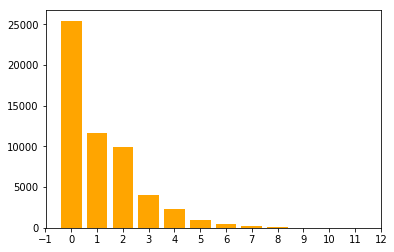

In [20]:
# Find 'imporatnce' of each mode
[start,end] = [0,12]
plt.bar(range(len(Sigma[start:end])),Sigma[start:end],color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.savefig('./Images/question2Sigma.png')

In [21]:
# ^ => can use about 8 
timeDelayOrder = 8
[Ph,Lh,bh] = DMD(H,Hp,timeDelayOrder)
print([Ph.shape,Lh.shape,bh.shape])

[(1746, 8), (8, 8), (8,)]


In [22]:
dmdH = PredictDMD(Ph,Lh,bh,N)
print(dmdH.shape)

(1024, 1746)


In [23]:
XH = np.array([dmdH[0,::2],dmdH[0,1::2]]) 
# OK, weird shit happens here - taking first row is way better than columns
# But can we work out why?
# - Because the first row IS the data, I think
XH = np.array([dmdH[:,0],dmdH[:,1]]) 
# Sheish, this took nowhere near as long as the previous question
#  I'm almost in good spirits now, contemplating a musical acompanyment playlist.

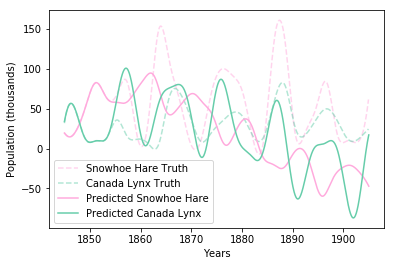

In [24]:
fig, ax = plt.subplots()

ax.plot(CreateXYear(X[0].T.shape[0]),X[0].T,c=millenialPink,alpha=0.5,linestyle='--',label='Snowhoe Hare Truth')
ax.plot(CreateXYear(X[1].T.shape[0]),X[1].T,c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Truth')
ax.plot(CreateXYear(np.real(XH[0].T).shape[0]),np.real(XH[0].T),c=millenialPink,label='Predicted Snowhoe Hare')
ax.plot(CreateXYear(np.real(XH[1].T).shape[0]),np.real(XH[1].T),c=mediumAquamarine,label='Predicted Canada Lynx')

ax.set_xlabel('Years')
ax.set_ylabel('Population (thousands)')

ax.legend()

plt.savefig('./Images/dmdEmbedded.png')

plt.show()

# TODO:
# - Axis
# - Seperate zoom-in?

# Ain't that pretty though - BEAUTIFUL colour scheme

## Question 3: Empirical Predator-Prey models such as Lotka-Volterra are commonly used to models such phenomenon. 
Consider the model $\dot{x} = (b − py)x$ and $\dot{y} = (rx − d)y$. Use the data to fit values of b, p, r and d.

In [25]:
# First create an approximation for derivatives
# Using centre-difference forumla
# \dot{x} = (x_t+1-x_t-1)/2dt
def CentreDiffApprox(X,dt):
    dXdt = X[2:] - X[:-2]
    #dXdt = np.divide(dXdt,dt*2)
    dXdt /= 2
    return [X[1:-1],dXdt]

In [26]:
# I can't see an obvious way to learn the model in one go, so will go ahead and 
#  Tackle as solving two different problems as variables are unqiue to each equation
print(X.shape)
dt = 1
newX,dXdt = CentreDiffApprox(X[0].T,dt=1)
newY,dYdt = CentreDiffApprox(X[1].T,dt=1)

#newX = X[0].T
#dXdt = np.gradient(newX)
#newY = X[1].T
#dYdt = np.gradient(newY)

print('New X and X derivative dimensions:')
print([newX.shape,dXdt.shape])
print('New Y and Y derivative dimensions:')
print([newY.shape,dYdt.shape])
print(X[0,2]-X[0,0])
print(dXdt[0])
print(newX[0])

(2, 1023)
New X and X derivative dimensions:
[(1021,), (1021,)]
New Y and Y derivative dimensions:
[(1021,), (1021,)]
-1.1878379733361157
-0.5939189866680579
19.385737370483675


### Lotka Voltera eqns to fit

$\dot{x} = (b-py)x$

$\dot{y} = (rx-d)y$

In [27]:
# Therefore need XY
newXY = np.multiply(newX,newY)
print(newXY.shape)

(1021,)


In [28]:
# xdot
#  lasso line appropriated from HW1
#dXmodel = linear_model.MultiTaskLassoCV(verbose=2,alphas=[0.1],copy_X=False,n_jobs=-1,normalize=False,max_iter=32)
Xl = np.array([newX,-newXY]) # X's library
print([Xl.shape,dXdt.shape])
dXmodel = linear_model.Lasso(0)
dXmodel.fit(Xl.T,dXdt)
[b,p] = dXmodel.coef_
print([b,p])

[(2, 1021), (1021,)]
[0.01464332863982769, 0.0003148540301065334]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:7: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  import sys
/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:478: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  positive)
/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:492: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [29]:
Yl = np.array([newXY,-newY]) # X's library
print(Yl.shape)
dYmodel = linear_model.Lasso(0)
dYmodel.fit(Yl.T,dYdt)
[r,d] = dYmodel.coef_
print([r,d])

(2, 1021)
[0.0001930372438654845, 0.0204932259635572]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:478: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  positive)
/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:492: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [30]:
def PInvKFold(A,B,k=5):
    kf = model_selection.KFold(n_splits=k)
    p = [np.linalg.pinv(A[i])@B[i] for i,_ in kf.split(A)]
    return np.mean(p,axis=0)

In [31]:
Xl = np.array([newX,-newXY]) # X's library
Yl = np.array([newXY,-newY]) # Y's library

In [32]:
xModel = np.linalg.pinv(Xl.T)@dXdt
yModel = np.linalg.pinv(Yl.T)@dYdt
xModel = PInvKFold(Xl.T,dXdt,3)
yModel = PInvKFold(Yl.T,dYdt,3)

In [33]:
dXdt_test = np.array([Xl.T@xModel]).T
dYdt_test = np.array([Yl.T@yModel]).T

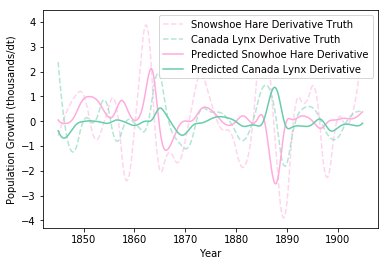

In [34]:
fig, ax = plt.subplots()

p = CreateXYear(dXdt.shape[0])
q = CreateXYear(dXdt_test.shape[0])

ax.plot(p,dXdt,c=millenialPink,alpha=0.5,linestyle='--',label='Snowshoe Hare Derivative Truth')
ax.plot(p,dYdt,c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Derivative Truth')
ax.plot(q,dXdt_test,c=millenialPink,label='Predicted Snowhoe Hare Derivative')
ax.plot(q,dYdt_test,c=mediumAquamarine,label='Predicted Canada Lynx Derivative')

ax.set_xlabel('Year')
ax.set_ylabel('Population Growth (thousands/dt)')

ax.legend()

plt.savefig('./Images/lvDiv.png')
plt.show()

In [35]:
y = dXmodel.predict([[20,32]])
print(y)
y = [20,32]@dXmodel.coef_
print(y)

[0.17177314]
0.3029419017599629


In [36]:
def LotkaVolteraStep(X,b,p,r,d):
    xy = X[0]*X[1]
    x = X[0]
    y = X[1]
    #xi = (b*x[0] - p*xy)*dt
    #yi = (-d*x[1] + r*xy)*dt
    #xi = dXmodel.predict([[x,-xy]])[0]
    #yi = dYmodel.predict([[xy,-y]])[0]
    xi = [x,-xy]@xModel
    yi = [xy,-y]@yModel
    return [x+xi,y+yi]

In [37]:
x1 = [newX[0],newY[0]]
print(LotkaVolteraStep(x1,b,p,r,d))
print([b,p,r,d])

[19.43488109467317, 34.079448435578605]
[0.01464332863982769, array([1845.        , 1845.05865119, 1845.11730239, ..., 1904.70691636,
       1904.76556756, 1904.82421875]), 0.0001930372438654845, 0.0204932259635572]


In [38]:
lvX = [x1]
for i in range(N):
    lvX.append(LotkaVolteraStep(lvX[-1],b,p,r,d))

lvX = np.array(lvX)

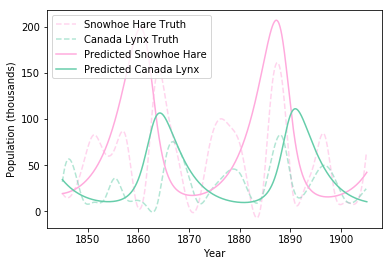

In [39]:
fig, ax = plt.subplots()

q = CreateXYear(X[0].T.shape[0])
p = CreateXYear(lvX[:,0].shape[0])

ax.plot(q,X[0].T,c=millenialPink,alpha=0.5,linestyle='--',label='Snowhoe Hare Truth')
ax.plot(q,X[1].T,c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Truth')
ax.plot(p,lvX[:,0],c=millenialPink,label='Predicted Snowhoe Hare')
ax.plot(p,lvX[:,1],c=mediumAquamarine,label='Predicted Canada Lynx')

ax.set_xlabel('Year')
ax.set_ylabel('Population (thousands)')

ax.legend()

plt.savefig('./Images/lkPlot.png')

plt.show()

## Question 4: Find the best fit nonlinear, dynamical systems model to the data using sparse regression.

Kinda similar to the last question, but we want a crazier library - and therefore to introduce sparsity.

In [40]:
print(X.shape)
x = X[0]
y = X[1]
D = np.array([dXdt,dYdt]).T

(2, 1023)


In [41]:
def LibraryPolynomial(X,o=2):
    n = X.shape[1]
    L = np.array([np.ones(n).T])
    for i in range(o):
        l =[]
        for j in range(i+1):
            lt = np.array([np.multiply(np.power(X[0],i-j),np.power(X[1],j))]).T
            L = np.vstack([L,lt.T])
    return L[1:]

In [42]:
order = 4
L = LibraryPolynomial(X[:,1:-1],order)
print(D.shape)
print(L.shape)
print(L[:,0])

(1021, 2)
(10, 1021)
[1.00000000e+00 1.93857374e+01 3.44631186e+01 3.75806813e+02
 6.68092966e+02 1.18770654e+03 7.28529219e+03 1.29514748e+04
 2.30245671e+04 4.09320715e+04]


In [43]:
lassoModel = linear_model.MultiTaskLassoCV(cv=3,verbose=0,alphas=[0.001],copy_X=False,n_jobs=-1,normalize=False)
lassoModel.fit(L.T,D) # This can take a couple minutes on my teeny macbook pro, like a couple^2
print(lassoModel.coef_.shape)

(2, 10)


/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:492: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/usr/local/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:1822: ConvergenceWarning: Objective did not converge, you might want to increase the number of iterations
  ConvergenceWarning)


In [44]:
cv = np.reshape(lassoModel.coef_,[np.product(lassoModel.coef_.shape)])
print(cv.shape)

(20,)


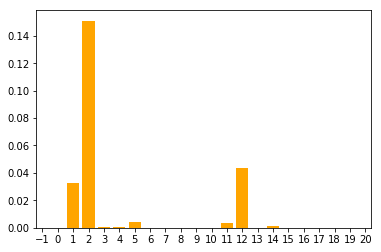

In [45]:
plt.bar(range(len(cv)),np.abs(cv),color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.savefig('./Images/nlCoef.png')

In [46]:
# Iterate, in order to plot derivatives
results = []
for l in L.T:
    results.append(lassoModel.predict([l])[0])

results = np.array([results]).T
print(results.shape)
print(results[0,:].shape[0])

(2, 1021, 1)
1021


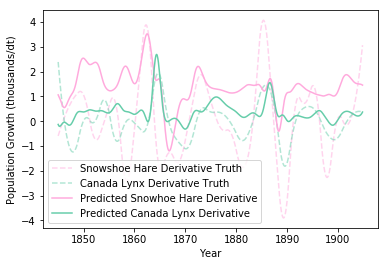

In [47]:
fig, ax = plt.subplots()

q = CreateXYear(dXdt.T.shape[0])
p = CreateXYear(results[0,:].shape[0])

ax.plot(q,dXdt,c=millenialPink,alpha=0.5,linestyle='--',label='Snowshoe Hare Derivative Truth')
ax.plot(q,dYdt,c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Derivative Truth')
ax.plot(p,results[0,:],c=millenialPink,label='Predicted Snowhoe Hare Derivative')
ax.plot(p,results[1,:],c=mediumAquamarine,label='Predicted Canada Lynx Derivative')

ax.set_xlabel('Year')
ax.set_ylabel('Population Growth (thousands/dt)')

ax.legend()

plt.savefig('./Images/nlDiv.png')
plt.show()

In [48]:
def ModelStep(model,X,o):
    x = LibraryPolynomial(X,o).T
    d = model.predict(x).T
    return X+d

In [49]:
nlX = [np.array([x1]).T]
print(N)
for i in range(N):
    nlX.append(ModelStep(lassoModel,nlX[-1],order))

nlX = np.array(nlX)

1024


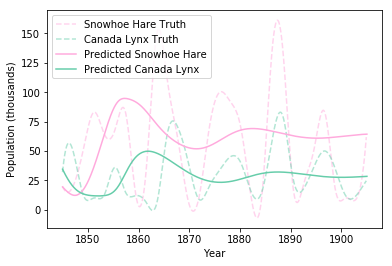

In [50]:
fig, ax = plt.subplots()

q = CreateXYear(X[0].shape[0])
p = CreateXYear(nlX[:,0].shape[0])

ax.plot(q,X[0],c=millenialPink,alpha=0.5,linestyle='--',label='Snowhoe Hare Truth')
ax.plot(q,X[1],c=mediumAquamarine,alpha=0.5,linestyle='--',label='Canada Lynx Truth')
ax.plot(p,nlX[:,0],c=millenialPink,label='Predicted Snowhoe Hare')
ax.plot(p,nlX[:,1],c=mediumAquamarine,label='Predicted Canada Lynx')

ax.set_xlabel('Year')
ax.set_ylabel('Population (thousands)')

ax.legend()

plt.savefig('./Images/nlPlot.png')

plt.show()

## Question 5: Compute the KL divergence of the best model fit to the data between all the above models.

Information theory is fun. (I wrote this before attempting the code)

In [51]:
# It doesn't feel right to call is a true probability dist. - don't ask me why
def CreatePseudoProbDist(X,b,c=0.001):
    f,_ = np.histogram(X,bins=b)
    f = f.astype(float)
    f += c
    f /= np.trapz(f) # not 100% needed becauase scipy.stats.entropy normalises
    return f

In [52]:
# Think I need these to be able to compare and contrast
b = 128
binCentres = np.linspace(0,200,b)

In [53]:
x = X[0]
xDMD = dmdXt[:,0]
xDMDt = XH[0].T
print(lvX.shape)
xLV = lvX[:,0]
xNL = nlX[:,0]
modelXs = {'truth':x,'DMD':xDMD,'DMD (time delayed)':xDMDt,'Lotka-Voltera':xLV,'Non-linear':xNL}

(1025, 2)


In [54]:
modelDist = {a:CreatePseudoProbDist(modelXs[a],binCentres) for a in modelXs}

In [55]:
for i in modelDist:
    print(i)
    print(scipy.stats.entropy(modelDist['truth'],modelDist[i]))

truth
0.0
DMD
4.109787922974491
DMD (time delayed)
1.376358373642346
Lotka-Voltera
2.3485936030543955
Non-linear
3.1784722175415006


## Question 6: Retain three of your best fit models and compare their AIC and BIC scores

In [56]:
# THIS IS ALL VERY DUBIOUS
# I'M PRETTY SURE AIC AND BIC ARE INVERSELY PROPERTIONAL TO THE TRUTH

In [57]:
# AIC = 2k + n ln(RSS)
def AIC(k,n,x,xh):
    r = np.abs(x-xh)
    L = np.sum(np.power(r,2))
    return 2*k + n*np.log(L)

In [58]:
# BIC = k*ln(n) + n*ln(RSS/n)
def BIC(k,n,x,xh):
    r = np.abs(x-xh)
    L = np.sum(np.power(r,2))
    return k*np.log(n) + n*np.log(L/n)

In [59]:
# DMD
print(AIC(2,xDMD.shape[0],xDMD,x[:1]))
print(BIC(2,xDMD.shape[0],xDMD,x[:1]))

15067.732831400295
7979.768646077653


In [60]:
# DMD (time-delayed)
print(AIC(timeDelayOrder,xDMDt.shape[0],xDMD,x[:1]))
print(BIC(timeDelayOrder,xDMDt.shape[0],xDMD,x[:1]))

15079.732831400295
8021.35747691125


In [61]:
# Lotka-Voltera
print(AIC(2,xLV.shape[0],xLV,x[:1]))
print(BIC(2,xLV.shape[0],xLV,x[:1]))

16049.475199835791
8953.581006757113


In [62]:
# Non-Linear
print(AIC(L.shape[0],xNL.shape[0],xNL,x[:1]))
print(BIC(L.shape[0],xNL.shape[0],xNL,x[:1]))

14934.309291789285
7877.87468184319


## Weird Beluosov-Zhabotinsky movie section
This is pretty intensive stuff, and require the data file form course website - which is 'UGE.

In [63]:
filePath = './BZ.mat'
f = h5py.File(filePath, 'r')
bzDataOriginal = {}
for k,v in f.items():
    bzDataOriginal[k] = np.array(v)
f.close()

In [64]:
print(bzDataOriginal.keys())
bzData = np.array(bzDataOriginal[list(bzDataOriginal.keys())[0]])
print(bzData.shape)

dict_keys(['BZ_tensor'])
(1200, 451, 351)


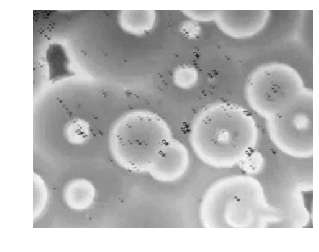

In [65]:
plt.imshow(bzData[10].T,cmap='gray')
plt.axis('off')
plt.show()

In [66]:
# Stolen from a previous project 
#  CSE573 AI final proj, investigating 'stability' of autoencoders interpreted ass a dynamical system
#  https://colab.research.google.com/drive/1XCOS9NaT9olQRbiZG2lg8MTJKvEpr6Fd
def CreateGIF(anim_file,searchTerm):
    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob(searchTerm+'_[0-9]*.png')
        filenames = sorted(filenames)
        last = -1
        for i,filename in enumerate(filenames):
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

In [67]:
def SaveImages(Im,folderPath,fileName,number=True):
    for i in range(Im.shape[0]):
        #print('Saving image '+str(i+1)+' of '+str(Im.shape[0]))
        fN = folderPath+'/'+fileName
        if number == True: fN+='_{:05d}'.format(i)
        plt.imshow(Im[i],cmap='gray',aspect='auto')
        plt.axis('off')
        plt.gca().set_axis_off()
        plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0,hspace = 0, wspace = 0)
        plt.margins(0,0)
        plt.gca().xaxis.set_major_locator(plt.NullLocator())
        plt.gca().yaxis.set_major_locator(plt.NullLocator())
        plt.savefig(fN+'.png')
        plt.close()

In [68]:
SaveImages(np.array(bzData[:63]),'./DATA','fullSample')

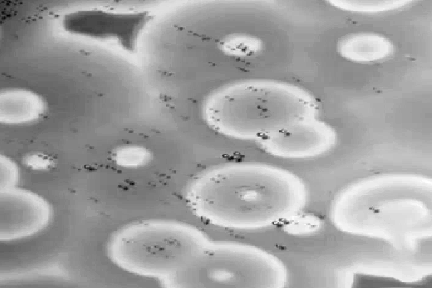

In [69]:
CreateGIF('fullSample.gif','./Data/fullSample')
display.Image('fullSample.gif')

In [70]:
from skimage.measure import block_reduce

In [71]:
# Create a new tensor of reduced data, and then delete bzData - as it's like 100mb
nD = block_reduce(bzData[:,:-1,:-1],block_size=(1,5,5),func=np.mean) # new data
print(nD.shape)
print(bzData.shape)
bzData = None
bzDataOriginal = None

(1200, 90, 70)
(1200, 451, 351)


In [72]:
SaveImages(np.array(nD[:64]),'./DATA','reduced')

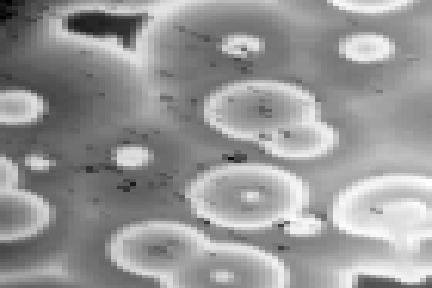

In [73]:
CreateGIF('reduced.gif','./Data/reduced')
display.Image('reduced.gif')

In [74]:
rows = nD.shape[1]
cols = nD.shape[2]
nDv = np.reshape(nD,[nD.shape[0],rows*cols])
print(nDv.shape)

(1200, 6300)


In [75]:
U,Sigma,VT = np.linalg.svd(nDv)

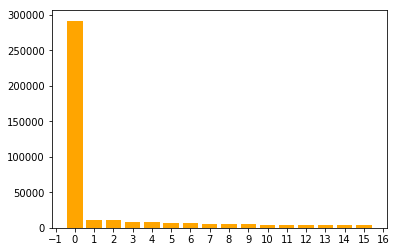

In [76]:
# As is tradition
[start,end] = [0,16]
plt.bar(range(len(Sigma[start:end])),Sigma[start:end],color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.savefig('./Images/bzBar.png')

In [77]:
print(nDv[:-1].shape)
[P,L,b] = DMD(nDv[:-1].T,nDv[1:].T,30)

(1199, 6300)


In [78]:
q = 128
pIm = PredictDMD(P,L,b,q)

In [79]:
print(pIm.shape)
pIm = np.real(np.reshape(pIm,[pIm.shape[0],rows,cols]))
print(pIm.shape)

(128, 6300)
(128, 90, 70)


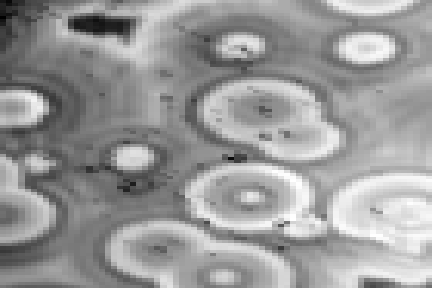

In [80]:
SaveImages(pIm,'./DATA','prediction')
CreateGIF('prediction.gif','./Data/prediction')
display.Image('prediction.gif')